In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from gadgetutils import snapshot, utils

In [2]:
plt.style.use(["science", "notebook"])

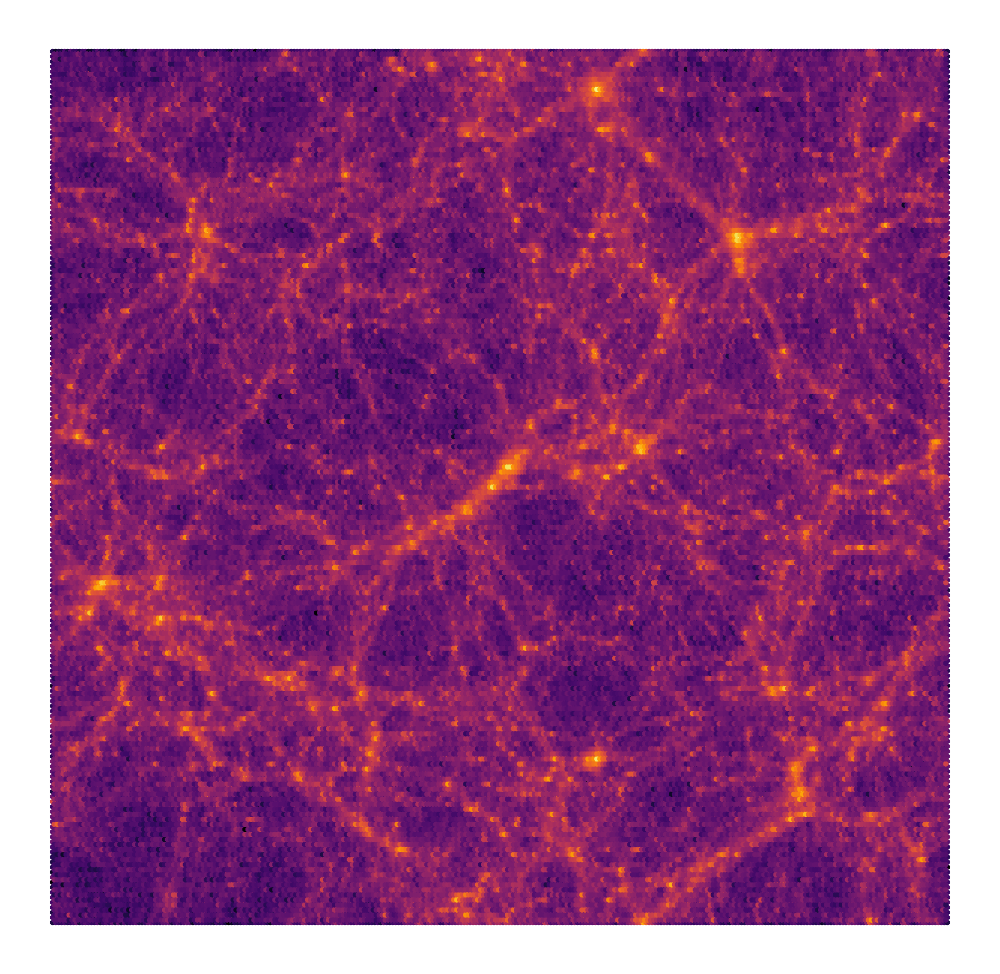

In [16]:
run = 14

center = np.array([0, 0, 0])

pd = snapshot.load(f"/home/aaronjo2/caps/astr510_sims/run{run}/snapshot_002.hdf5", load_vels=False, load_ids=False)
pos = utils.center_box_pbc(pd.pos, center, pd.box_size)
mask = np.nonzero(np.abs(pos[:,2]) < 20)

ratio = 1
x_size = 8

plt.figure(figsize=(x_size, ratio*x_size), dpi=300, frameon=False)
x_extent = pd.box_size / 2
y_extent = ratio * x_extent
plt.hexbin(pos[mask,0], pos[mask,1], cmap="inferno", norm=LogNorm(), gridsize=300, extent=(-x_extent,x_extent, -y_extent,y_extent))
plt.axis('off')
plt.show()

0 starting slice
0 starting halo
1 starting slice
1 starting halo
2 starting slice
2 starting halo


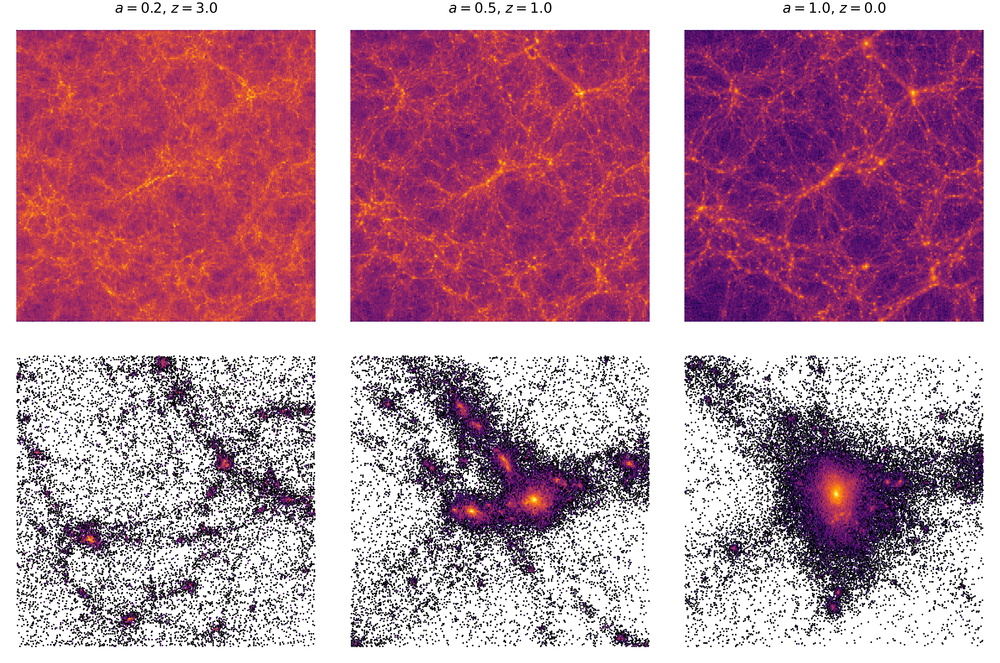

In [4]:
run = 14

center_slice = np.array([0, 0, 0])
hc = snapshot.load(f"/home/aaronjo2/caps/astr510_sims/run{run}/fof_subhalo_tab_004.hdf5")
center_halo = hc.pos[0]

fig = plt.figure(figsize=(24,16), dpi=300, frameon=False)

for i in range(3):
    print(i, "starting slice")
    pd = snapshot.load(f"/home/aaronjo2/caps/astr510_sims/run{run}/snapshot_{i:03}.hdf5", load_vels=False, load_ids=False)
    pos = utils.center_box_pbc(pd.pos, center_slice, pd.box_size)
    mask = np.nonzero(np.abs(pos[:,2]) < 20)

    plt.subplot(2,3,i+1)
    plt.hexbin(pos[mask,0], pos[mask,1], cmap="inferno", norm=LogNorm(), gridsize=300)
    plt.axis('off')
    plt.title(f"$a={pd.a:.1f}$, $z={pd.z:.1f}$", fontsize=24)
    
    print(i, "starting halo")
    pos = utils.center_box_pbc(pd.pos, center_halo, pd.box_size)
    mask = np.nonzero(np.prod(np.abs(pos) < 5, axis=1))
    plt.subplot(2,3,i+4)
    plt.hexbin(pos[mask,0], pos[mask,1], cmap="inferno", norm=LogNorm(), gridsize=300, mincnt=1)
    plt.axis('off')
    
fig.tight_layout()
plt.show()